modified keras UNET based on pix to pix generator, descriminator is as it is

#### tensorflow_examples package used to  import of the generator and the discriminator availabel in tensorflow package. This was used to just understand the code available.

In [1]:
!pip install git+https://github.com/tensorflow/examples.git

  Cloning https://github.com/tensorflow/examples.git to c:\users\navee\appdata\local\temp\pip-req-build-l_3b8b5n
  Resolved https://github.com/tensorflow/examples.git to commit 3df76a9e45e3a1d6165e42c565a2f8622f7c1f8c
  Preparing metadata (setup.py): started
  Preparing metadata (setup.py): finished with status 'done'


  Running command git clone --filter=blob:none --quiet https://github.com/tensorflow/examples.git 'C:\Users\navee\AppData\Local\Temp\pip-req-build-l_3b8b5n'


In [2]:
import tensorflow as tf

In [3]:
import tensorflow_datasets as tfds
from tensorflow_examples.models.pix2pix import pix2pix


import os
import time
import matplotlib.pyplot as plt
from IPython.display import clear_output

AUTOTUNE = tf.data.AUTOTUNE

C:\Users\navee\anaconda3\envs\testing_clone\lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


### Load horses and zebra dataset from tensorflow dataset

In [4]:
dataset, metadata = tfds.load('cycle_gan/horse2zebra',
                              with_info=True, as_supervised=True)

train_horses, train_zebras = dataset['trainA'], dataset['trainB']
test_horses, test_zebras = dataset['testA'], dataset['testB']


In [5]:
BUFFER_SIZE = 1000
BATCH_SIZE = 2
IMG_WIDTH = 256
IMG_HEIGHT = 256

In [6]:
def random_crop(image):
  cropped_image = tf.image.random_crop(
      image, size=[IMG_HEIGHT, IMG_WIDTH, 3])

  return cropped_image

In [7]:

def normalize(image):
  image = tf.cast(image, tf.float32)
  image = (image / 127.5) - 1
  return image

In [8]:
def random_apply(image):

  image = tf.image.resize(image, [286, 286],
                          method=tf.image.ResizeMethod.NEAREST_NEIGHBOR)

  image = random_crop(image)

  image = tf.image.random_flip_left_right(image)

  return image

In [9]:
def preprocess_image_train(image, label):
  image = random_apply(image)
  image = normalize(image)
  return image

In [10]:
def preprocess_image_test(image, label):
  image = normalize(image)
  return image

In [11]:
train_horses = train_horses.cache().map(
    preprocess_image_train, num_parallel_calls=AUTOTUNE).shuffle(
    BUFFER_SIZE).batch(BATCH_SIZE)

train_zebras = train_zebras.cache().map(
    preprocess_image_train, num_parallel_calls=AUTOTUNE).shuffle(
    BUFFER_SIZE).batch(BATCH_SIZE)

test_horses = test_horses.map(
    preprocess_image_test, num_parallel_calls=AUTOTUNE).cache().shuffle(
    BUFFER_SIZE).batch(BATCH_SIZE)

test_zebras = test_zebras.map(
    preprocess_image_test, num_parallel_calls=AUTOTUNE).cache().shuffle(
    BUFFER_SIZE).batch(BATCH_SIZE)

In [12]:
sample_horse = next(iter(train_horses))
sample_zebra = next(iter(train_zebras))

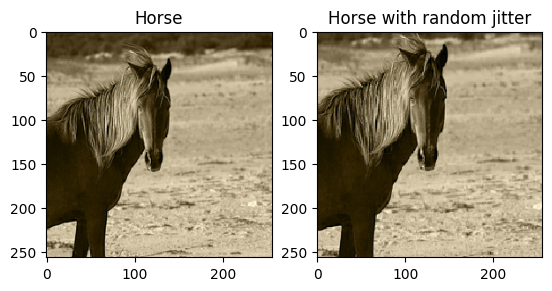

In [13]:
plt.subplot(121)
plt.title('Horse')
plt.imshow(sample_horse[0] * 0.5 + 0.5)

plt.subplot(122)
plt.title('Horse with random jitter')
plt.imshow(random_apply(sample_horse[0]) * 0.5 + 0.5)


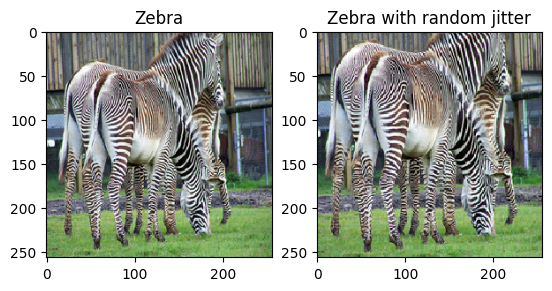

In [14]:
plt.subplot(121)
plt.title('Zebra')
plt.imshow(sample_zebra[0] * 0.5 + 0.5)

plt.subplot(122)
plt.title('Zebra with random jitter')
plt.imshow(random_apply(sample_zebra[0]) * 0.5 + 0.5)

In [15]:

from custom import custom_unet_generator_v2
generator_g = custom_unet_generator_v2()
generator_f = custom_unet_generator_v2()
print(generator_g.summary())

discriminator_x = pix2pix.discriminator(norm_type='instancenorm', target=False)
discriminator_y = pix2pix.discriminator(norm_type='instancenorm', target=False)

Model: "model"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 256, 256, 3) 0                                            
__________________________________________________________________________________________________
conv2d (Conv2D)                 (None, 256, 256, 64) 1728        input_1[0][0]                    
__________________________________________________________________________________________________
conv2d_1 (Conv2D)               (None, 128, 128, 64) 36864       conv2d[0][0]                     
__________________________________________________________________________________________________
conv2d_2 (Conv2D)               (None, 128, 128, 128 73728       conv2d_1[0][0]                   
______________________________________________________________________________________________

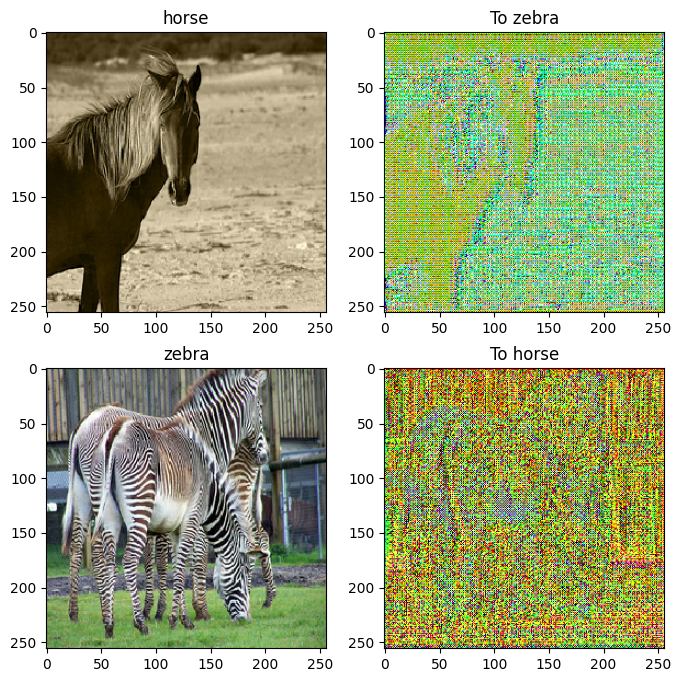

In [16]:
to_zebra = generator_g(sample_horse)
to_horse = generator_f(sample_zebra)
plt.figure(figsize=(8, 8))
contrast = 8

imgs = [sample_horse, to_zebra, sample_zebra, to_horse]
title = ['horse', 'To zebra', 'zebra', 'To horse']

for i in range(len(imgs)):
  plt.subplot(2, 2, i+1)
  plt.title(title[i])
  if i % 2 == 0:
    plt.imshow(imgs[i][0] * 0.5 + 0.5)
  else:
    plt.imshow(imgs[i][0] * 0.5 * contrast + 0.5)
plt.show()

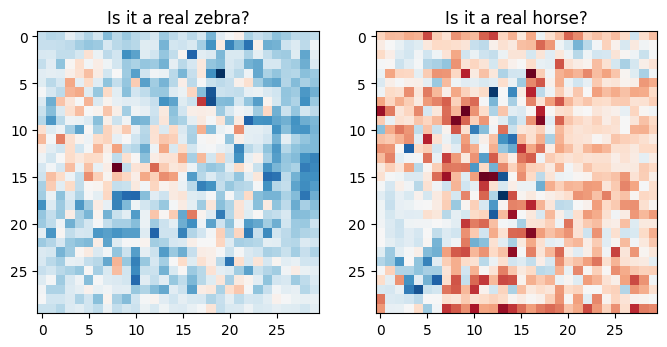

In [17]:
plt.figure(figsize=(8, 8))

plt.subplot(121)
plt.title('Is it a real zebra?')
plt.imshow(discriminator_y(sample_zebra)[0, ..., -1], cmap='RdBu_r')

plt.subplot(122)
plt.title('Is it a real horse?')
plt.imshow(discriminator_x(sample_horse)[0, ..., -1], cmap='RdBu_r')

plt.show()

## Loss functions

In [18]:
LAMBDA = 10

In [19]:
binary_loss = tf.keras.losses.BinaryCrossentropy(from_logits=True)

In [20]:
def discriminator_loss(real, generated):
  real_loss = binary_loss(tf.ones_like(real), real)

  generated_loss = binary_loss(tf.zeros_like(generated), generated)

  total_disc_loss = real_loss + generated_loss

  return total_disc_loss * 0.5

In [21]:
def generator_loss(generated):
  return binary_loss(tf.ones_like(generated), generated)

In [22]:
def calc_cycle_loss(real_image, cycled_image):
  loss1 = tf.reduce_mean(tf.abs(real_image - cycled_image))
  
  return LAMBDA * loss1

In [23]:
def identity_loss(real_image, same_image):
  loss = tf.reduce_mean(tf.abs(real_image - same_image))
  return LAMBDA * 0.5 * loss

In [24]:
generator_g_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)
generator_f_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)

discriminator_x_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)
discriminator_y_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)

## Checkpoints

In [25]:
checkpoint_path = "./checkpoints/train"

ckpt = tf.train.Checkpoint(generator_g=generator_g,
                           generator_f=generator_f,
                           discriminator_x=discriminator_x,
                           discriminator_y=discriminator_y,
                           generator_g_optimizer=generator_g_optimizer,
                           generator_f_optimizer=generator_f_optimizer,
                           discriminator_x_optimizer=discriminator_x_optimizer,
                           discriminator_y_optimizer=discriminator_y_optimizer)

ckpt_manager = tf.train.CheckpointManager(ckpt, checkpoint_path, max_to_keep=50)

# if a checkpoint exists, restore the latest checkpoint.
if ckpt_manager.latest_checkpoint:
  ckpt.restore(ckpt_manager.latest_checkpoint)
  print ('Latest checkpoint restored!!')

Latest checkpoint restored!!


In [26]:
EPOCHS = 50

In [27]:
def generate_images(model, test_input):
  prediction = model(test_input)
    
  plt.figure(figsize=(12, 12))

  display_list = [test_input[0], prediction[0]]
  title = ['Input Image', 'Predicted Image']

  for i in range(2):
    plt.subplot(1, 2, i+1)
    plt.title(title[i])

    plt.imshow(display_list[i] * 0.5 + 0.5)
    plt.axis('off')
  plt.show()

In [28]:

import numpy



@tf.function
def train_step(real_x, real_y):

  with tf.GradientTape(persistent=True) as tape:

    
    fake_y = generator_g(real_x, training=True)
    cycled_x = generator_f(fake_y, training=True)

    fake_x = generator_f(real_y, training=True)
    cycled_y = generator_g(fake_x, training=True)


    same_x = generator_f(real_x, training=True)
    same_y = generator_g(real_y, training=True)

    disc_real_x = discriminator_x(real_x, training=True)
    disc_real_y = discriminator_y(real_y, training=True)

    disc_fake_x = discriminator_x(fake_x, training=True)
    disc_fake_y = discriminator_y(fake_y, training=True)


    gen_g_loss = generator_loss(disc_fake_y)
    gen_f_loss = generator_loss(disc_fake_x)
    
    l1=calc_cycle_loss(real_x, cycled_x)
    l2=calc_cycle_loss(real_y, cycled_y)
    
    total_cycle_loss = l1 + l2
    
 
    total_gen_g_loss = gen_g_loss + total_cycle_loss + identity_loss(real_y, same_y)
    total_gen_f_loss = gen_f_loss + total_cycle_loss + identity_loss(real_x, same_x)

    disc_x_loss = discriminator_loss(disc_real_x, disc_fake_x)
    disc_y_loss = discriminator_loss(disc_real_y, disc_fake_y)

  generator_g_gradients = tape.gradient(total_gen_g_loss, 
                                        generator_g.trainable_variables)
  generator_f_gradients = tape.gradient(total_gen_f_loss, 
                                        generator_f.trainable_variables)
  
  discriminator_x_gradients = tape.gradient(disc_x_loss, 
                                            discriminator_x.trainable_variables)
  discriminator_y_gradients = tape.gradient(disc_y_loss, 
                                            discriminator_y.trainable_variables)
  
 
  generator_g_optimizer.apply_gradients(zip(generator_g_gradients, 
                                            generator_g.trainable_variables))

  generator_f_optimizer.apply_gradients(zip(generator_f_gradients, 
                                            generator_f.trainable_variables))
  
  discriminator_x_optimizer.apply_gradients(zip(discriminator_x_gradients,
                                                discriminator_x.trainable_variables))
  
  discriminator_y_optimizer.apply_gradients(zip(discriminator_y_gradients,
                                                discriminator_y.trainable_variables))
  return l1,l2,total_cycle_loss

......................................................534
534
534


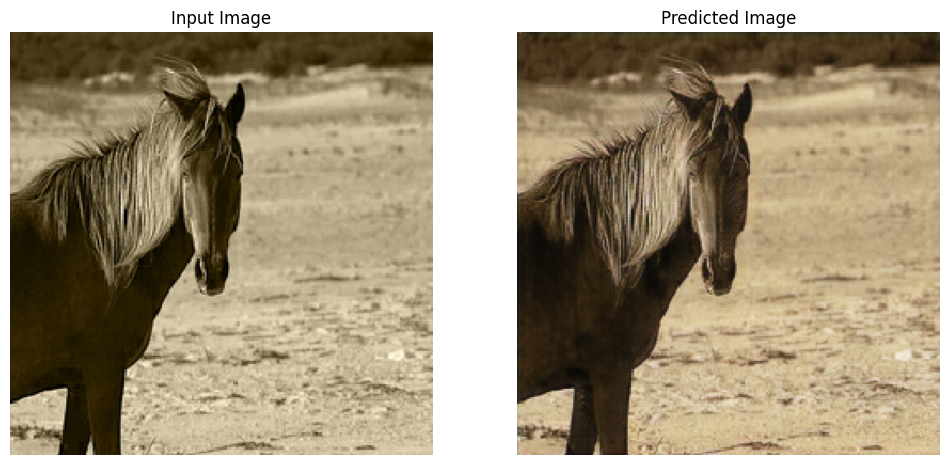

Time taken for epoch 1 is 200.85607147216797 sec

......................................................534
534
534


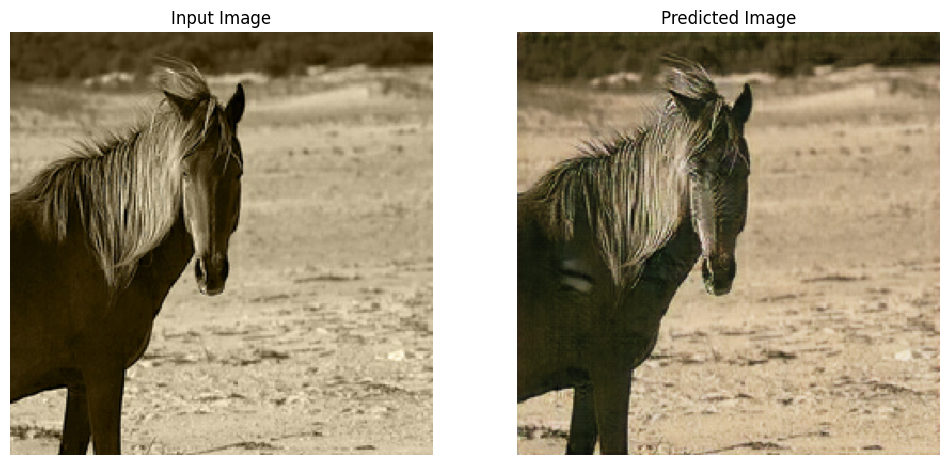

Time taken for epoch 2 is 181.21108746528625 sec

......................................................534
534
534


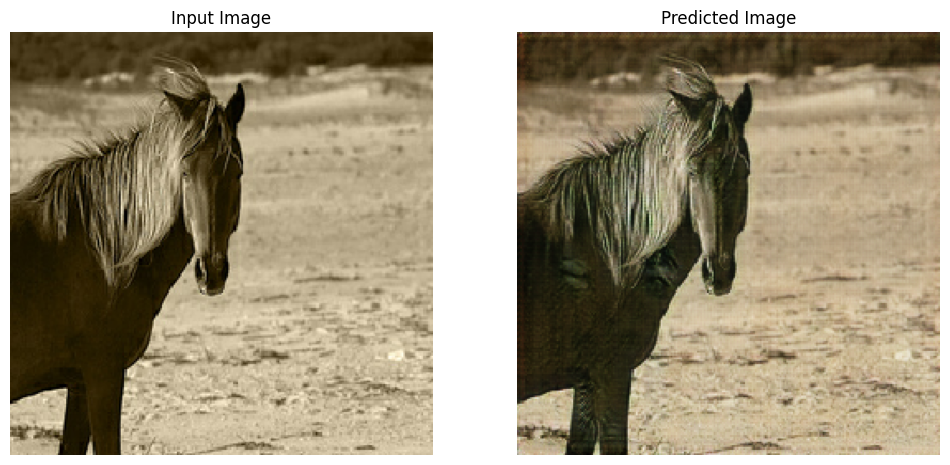

Time taken for epoch 3 is 180.0406527519226 sec

......................................................534
534
534


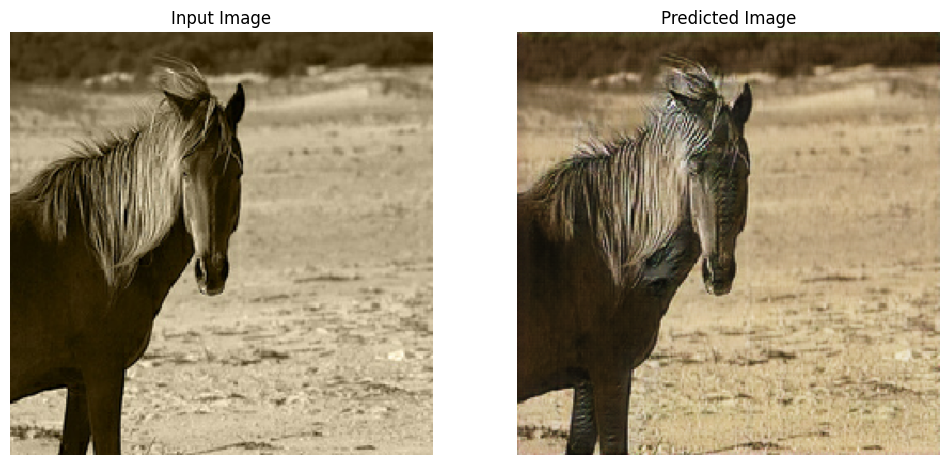

Time taken for epoch 4 is 180.54321146011353 sec

......................................................534
534
534


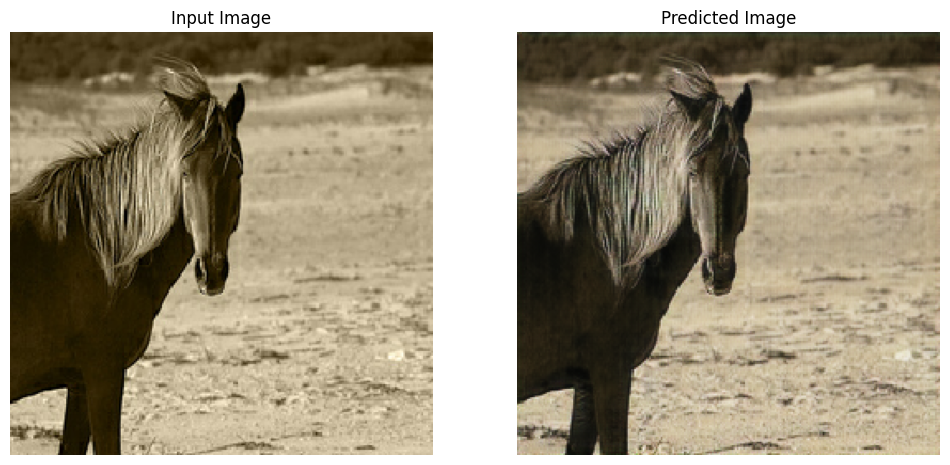

Saving checkpoint for epoch 5 at ./checkpoints/train\ckpt-14
Time taken for epoch 5 is 185.2069730758667 sec

......................................................534
534
534


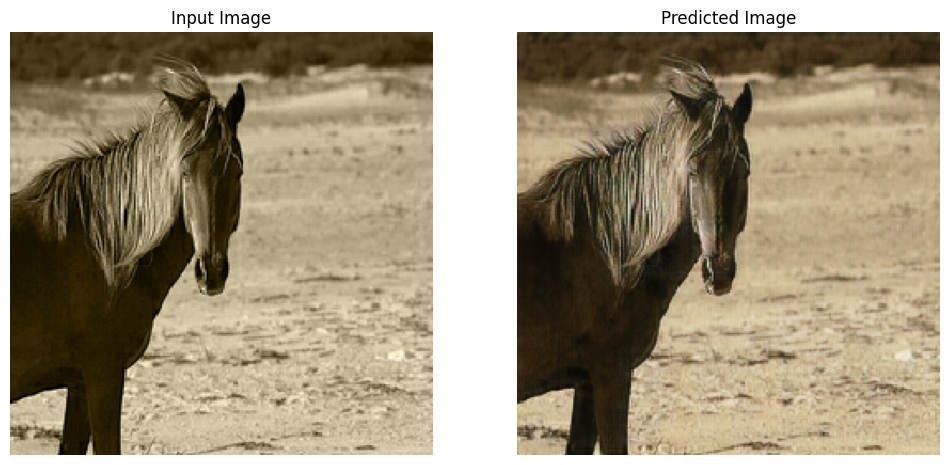

Time taken for epoch 6 is 179.70111799240112 sec

......................................................534
534
534


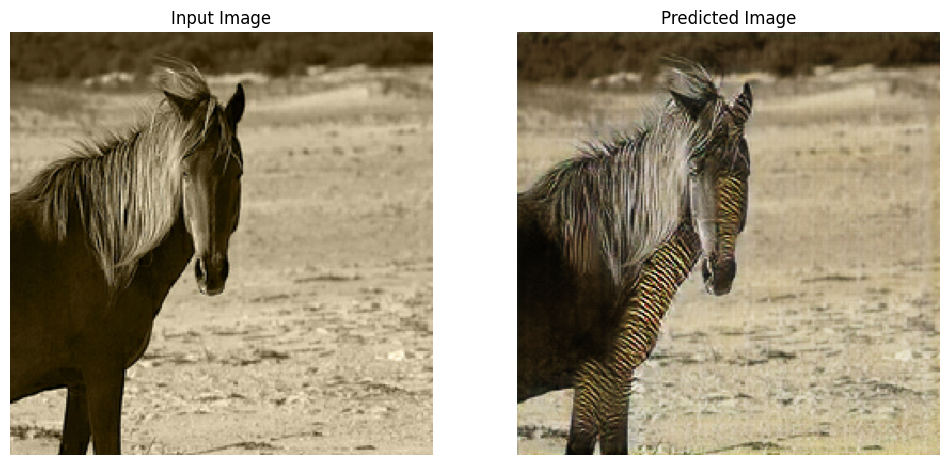

Time taken for epoch 7 is 179.76671504974365 sec

......................................................534
534
534


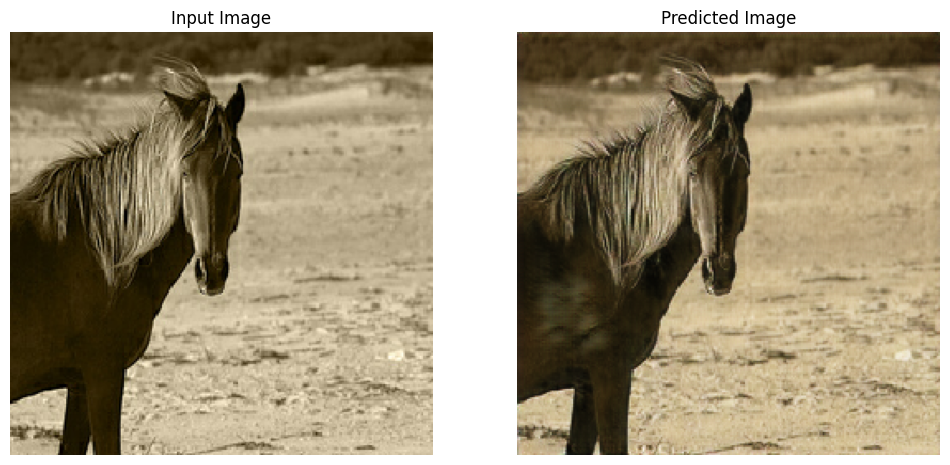

Time taken for epoch 8 is 179.57024836540222 sec

......................................................534
534
534


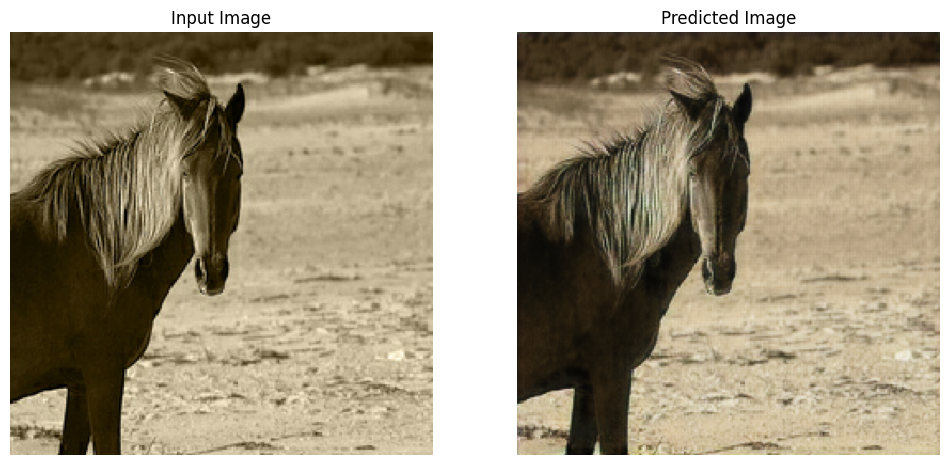

Time taken for epoch 9 is 179.5603325366974 sec

......................................................534
534
534


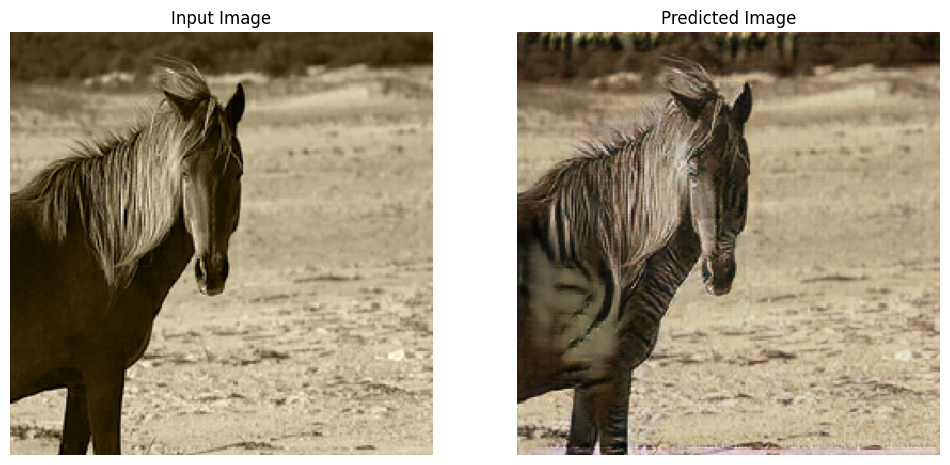

Saving checkpoint for epoch 10 at ./checkpoints/train\ckpt-15
Time taken for epoch 10 is 183.7507700920105 sec

......................................................534
534
534


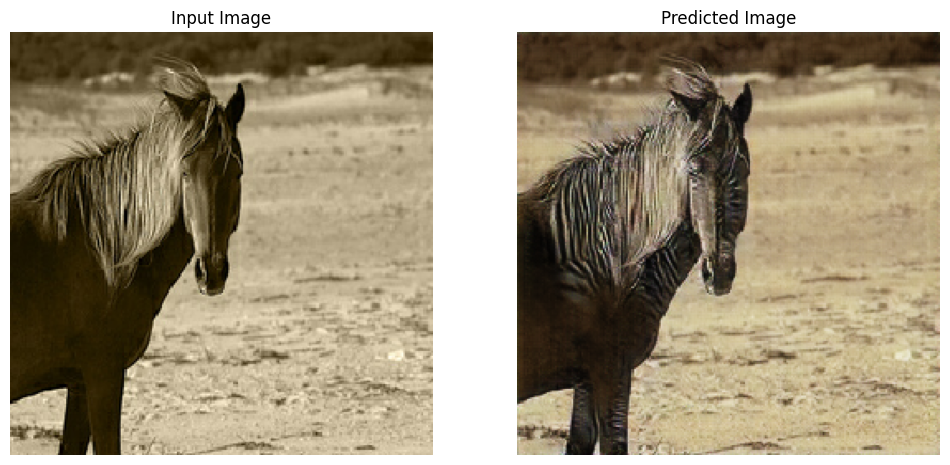

Time taken for epoch 11 is 180.04034733772278 sec

......................................................534
534
534


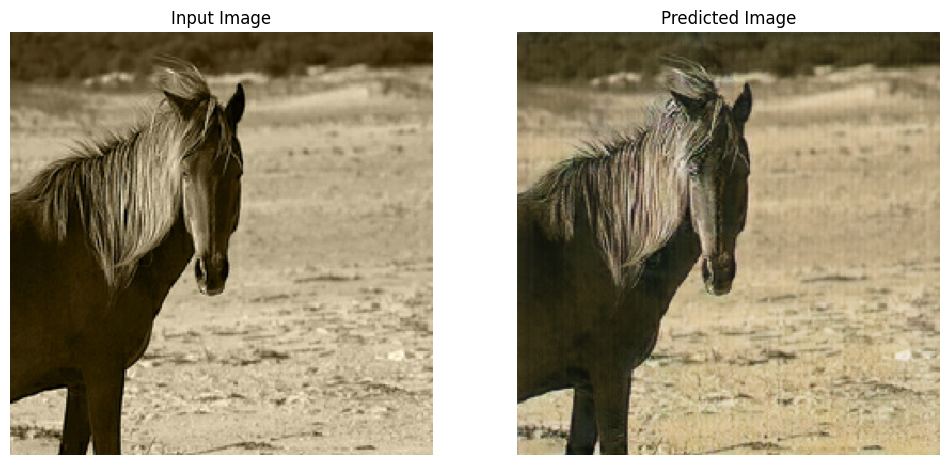

Time taken for epoch 12 is 179.08172273635864 sec

......................................................534
534
534


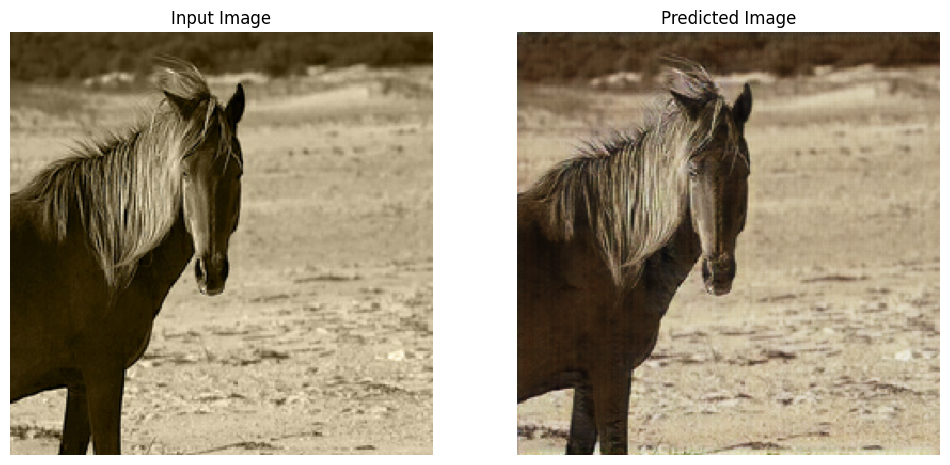

Time taken for epoch 13 is 179.76175904273987 sec

......................................................534
534
534


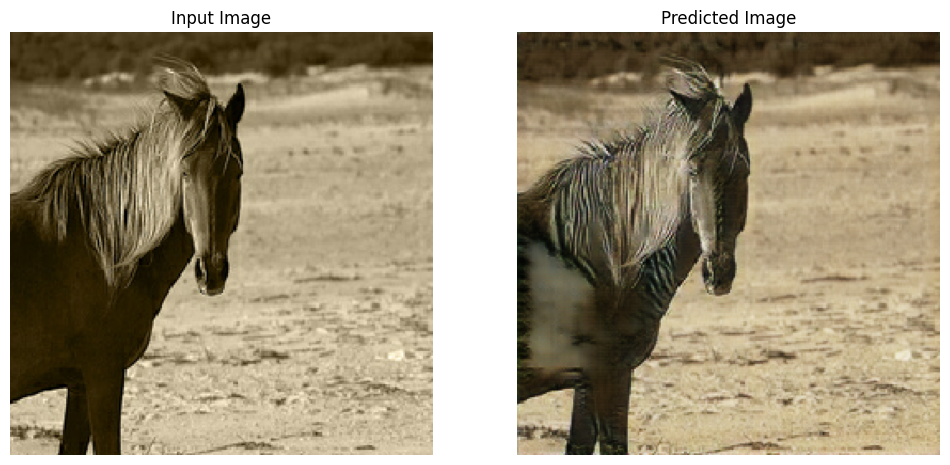

Time taken for epoch 14 is 180.4544816017151 sec

......................................................534
534
534


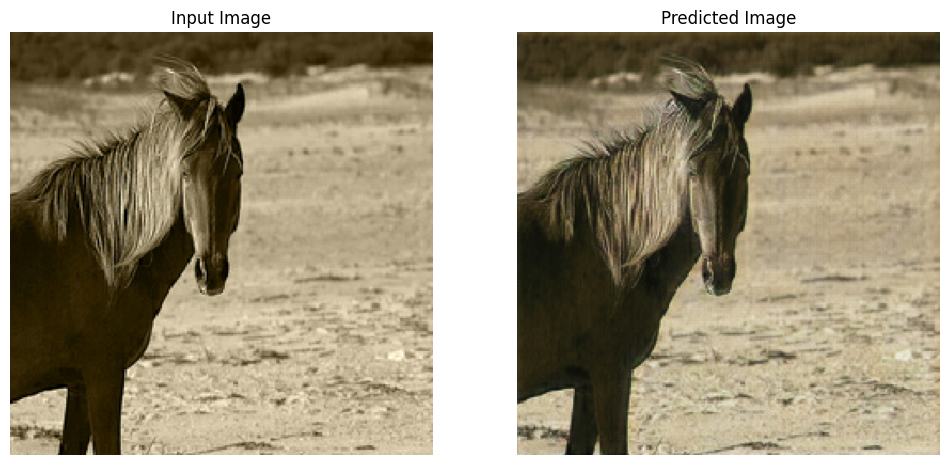

Saving checkpoint for epoch 15 at ./checkpoints/train\ckpt-16
Time taken for epoch 15 is 184.94092226028442 sec

......................................................534
534
534


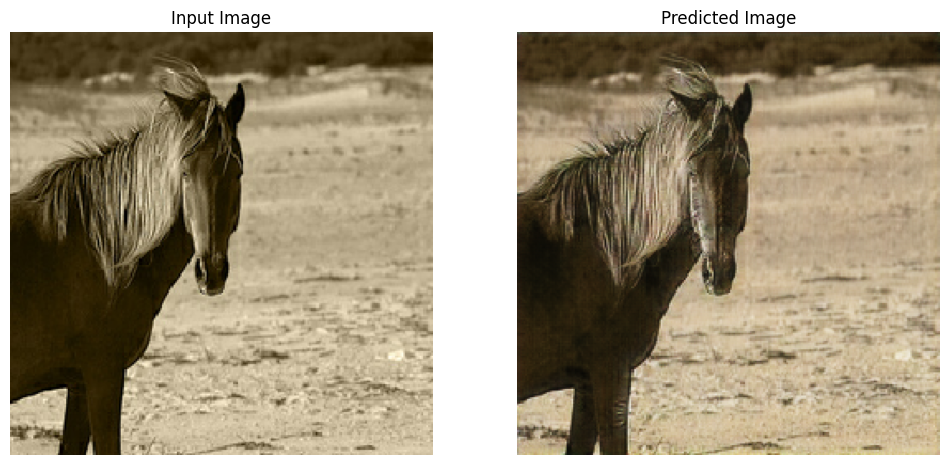

Time taken for epoch 16 is 181.07072710990906 sec

......................................................534
534
534


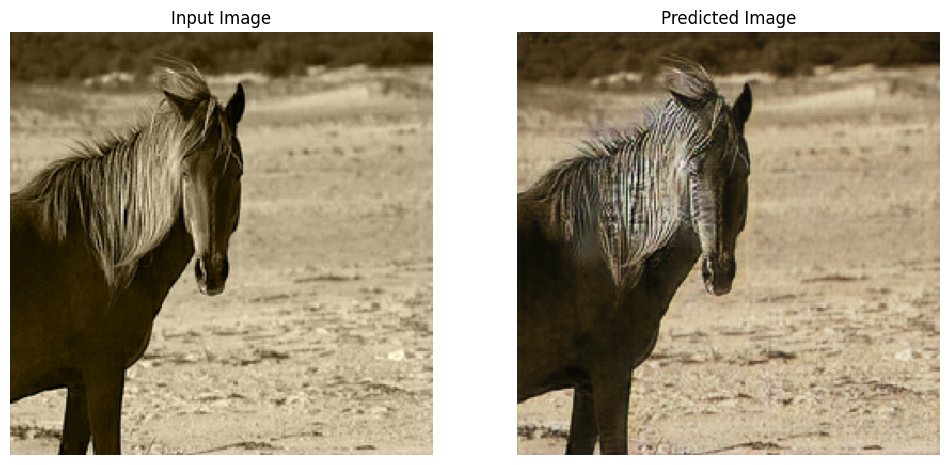

Time taken for epoch 17 is 180.31403827667236 sec

......................................................534
534
534


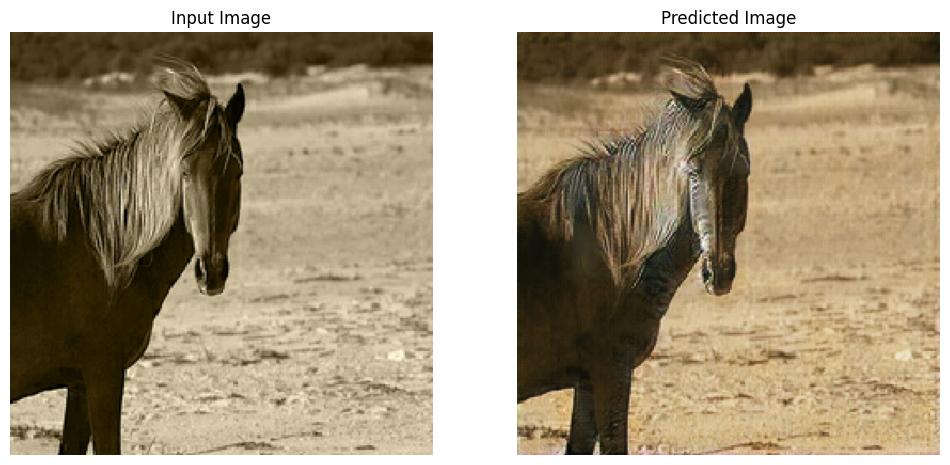

Time taken for epoch 18 is 180.36104607582092 sec

......................................................534
534
534


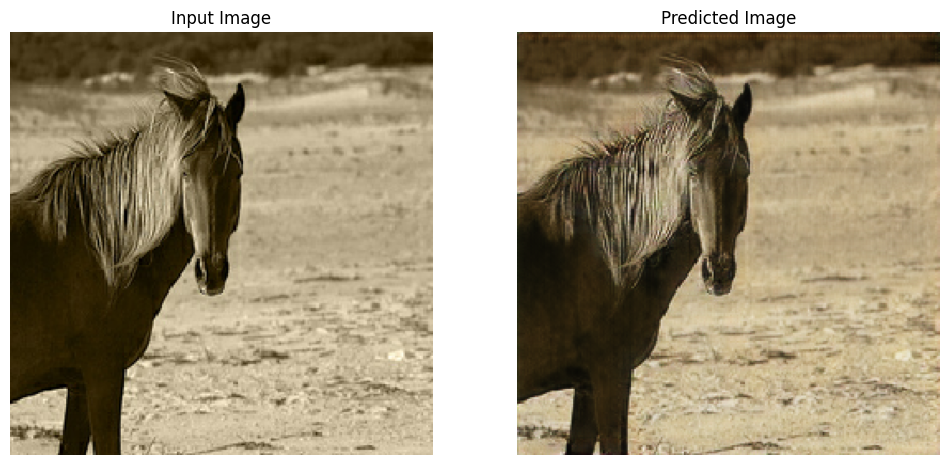

Time taken for epoch 19 is 180.4872612953186 sec

......................................................534
534
534


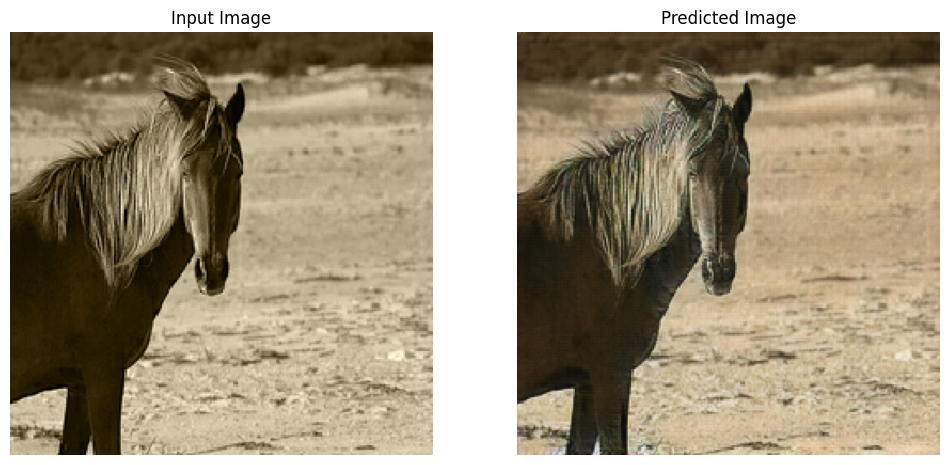

Saving checkpoint for epoch 20 at ./checkpoints/train\ckpt-17
Time taken for epoch 20 is 184.96247172355652 sec

......................................................534
534
534


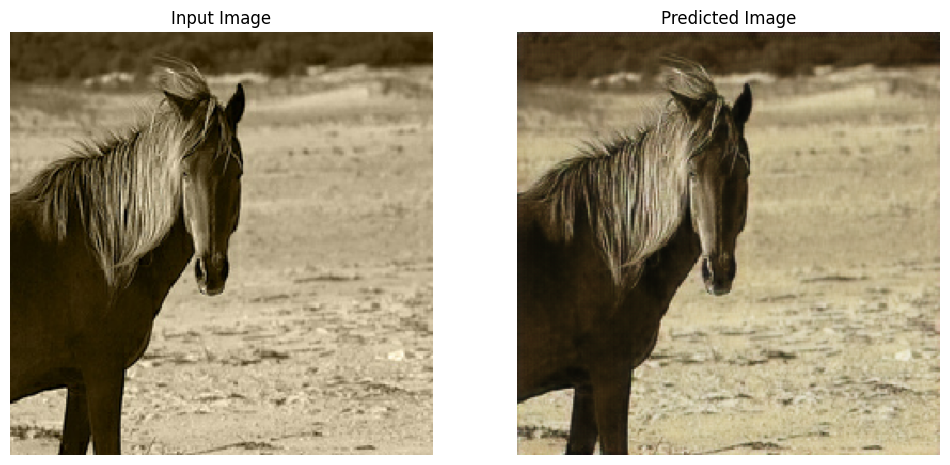

Time taken for epoch 21 is 180.64989066123962 sec

......................................................534
534
534


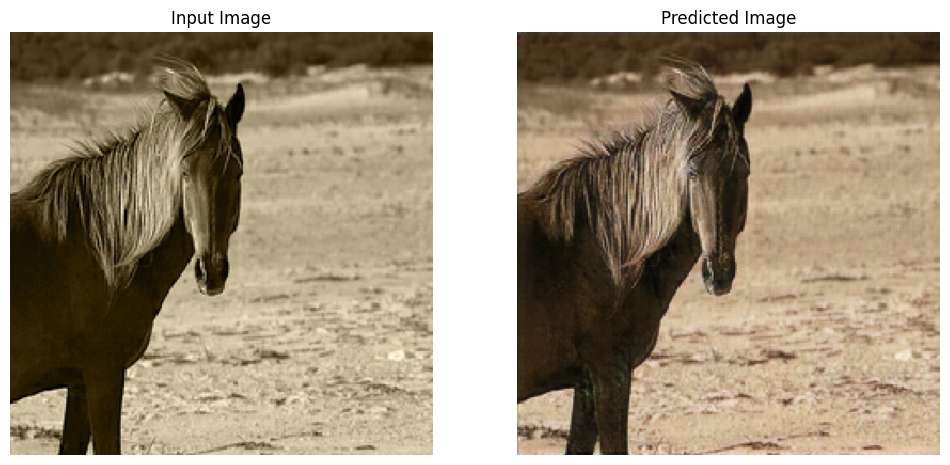

Time taken for epoch 22 is 180.86155223846436 sec

......................................................534
534
534


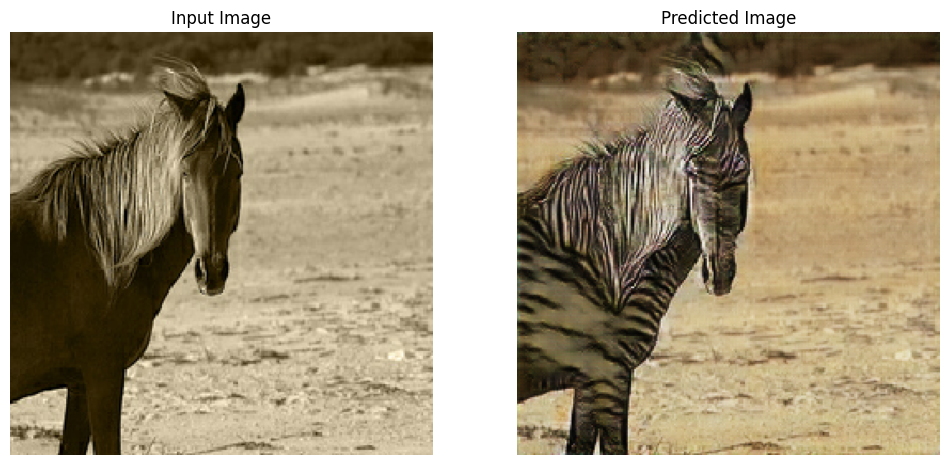

Time taken for epoch 23 is 180.80015444755554 sec

......................................................534
534
534


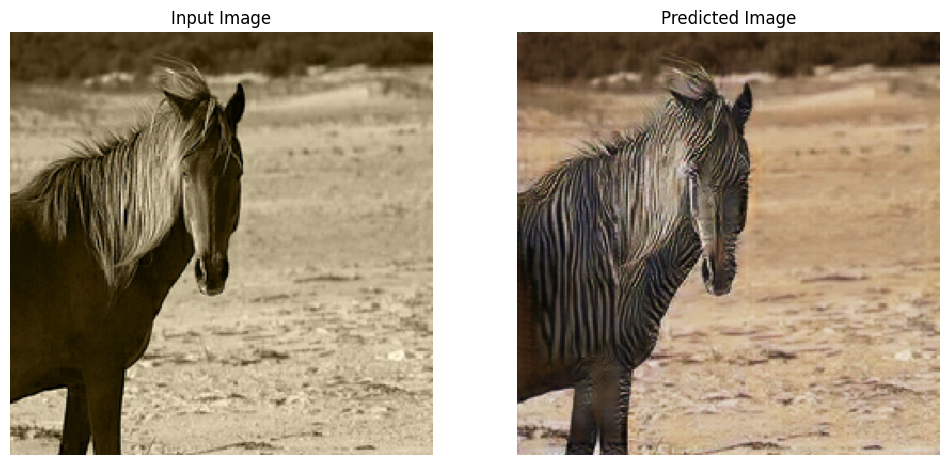

Time taken for epoch 24 is 182.34830021858215 sec

......................................................534
534
534


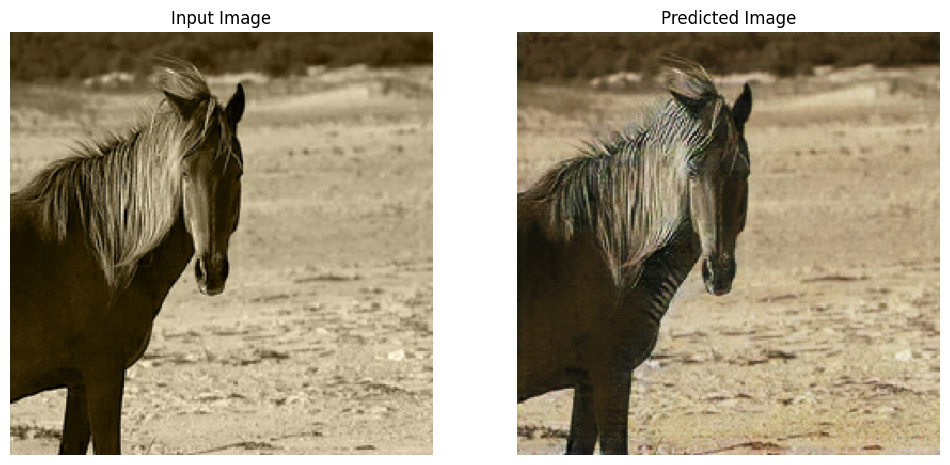

Saving checkpoint for epoch 25 at ./checkpoints/train\ckpt-18
Time taken for epoch 25 is 188.07319736480713 sec

......................................................534
534
534


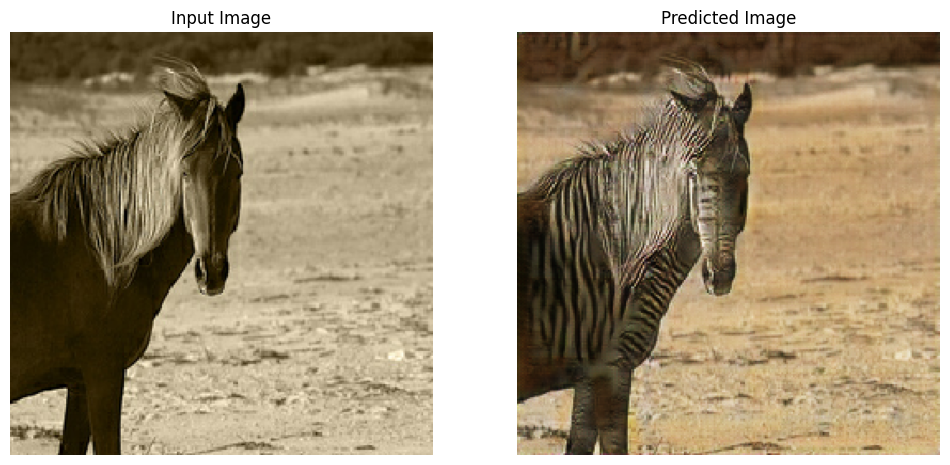

Time taken for epoch 26 is 181.14112496376038 sec

......................................................534
534
534


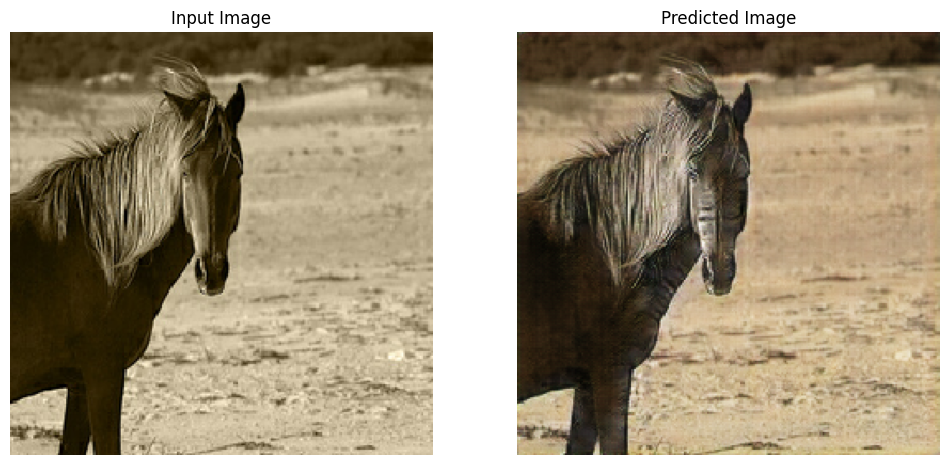

Time taken for epoch 27 is 181.44196701049805 sec

......................................................534
534
534


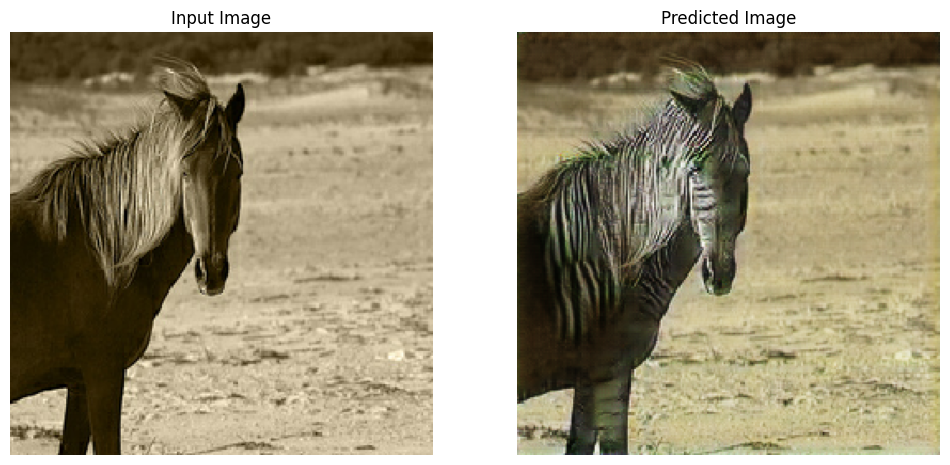

Time taken for epoch 28 is 181.50139832496643 sec

......................................................534
534
534


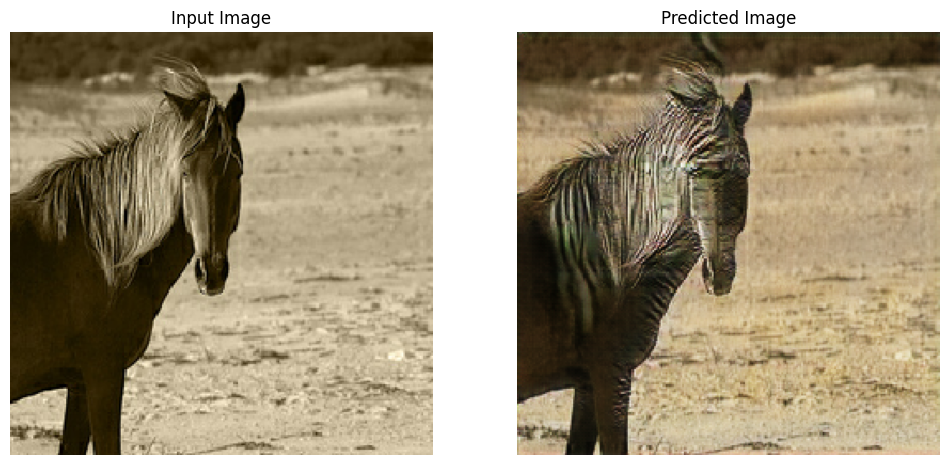

Time taken for epoch 29 is 181.48081755638123 sec

......................................................534
534
534


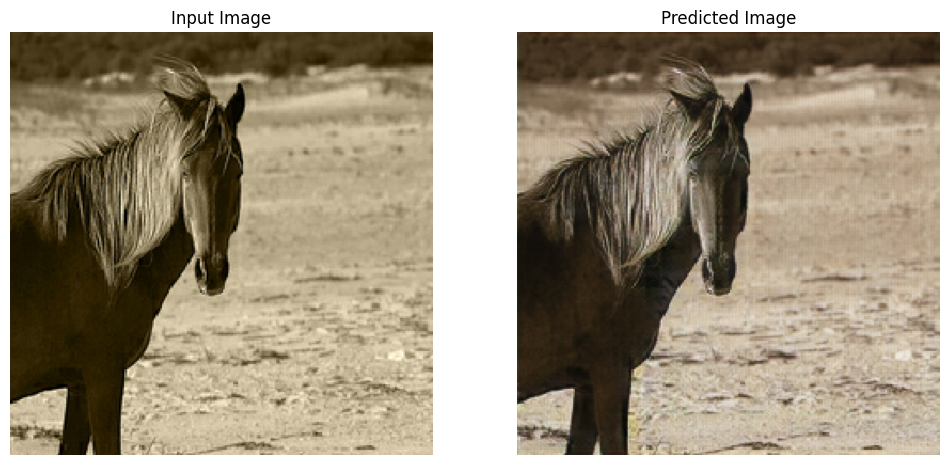

Saving checkpoint for epoch 30 at ./checkpoints/train\ckpt-19
Time taken for epoch 30 is 185.59546494483948 sec

......................................................534
534
534


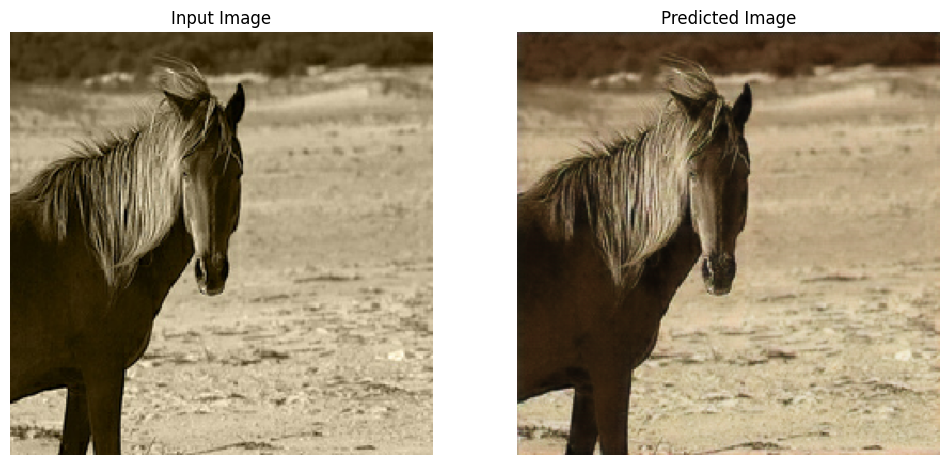

Time taken for epoch 31 is 182.01124382019043 sec

......................................................534
534
534


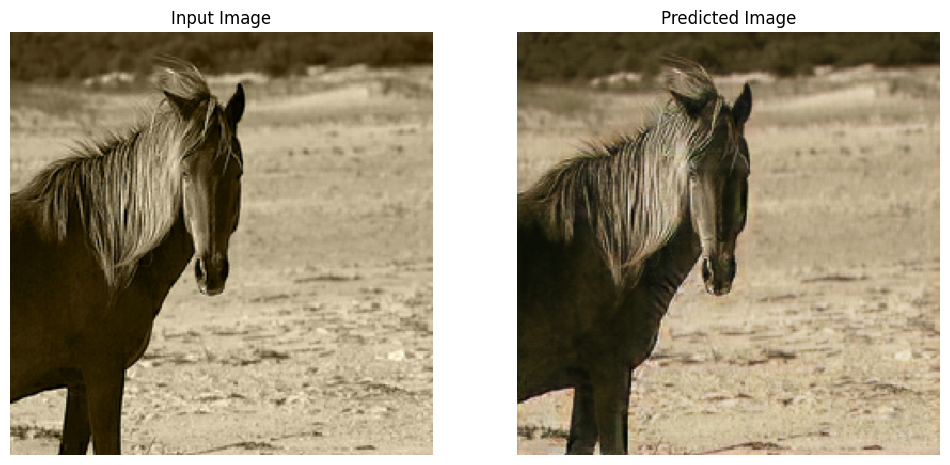

Time taken for epoch 32 is 182.00786972045898 sec

......................................................534
534
534


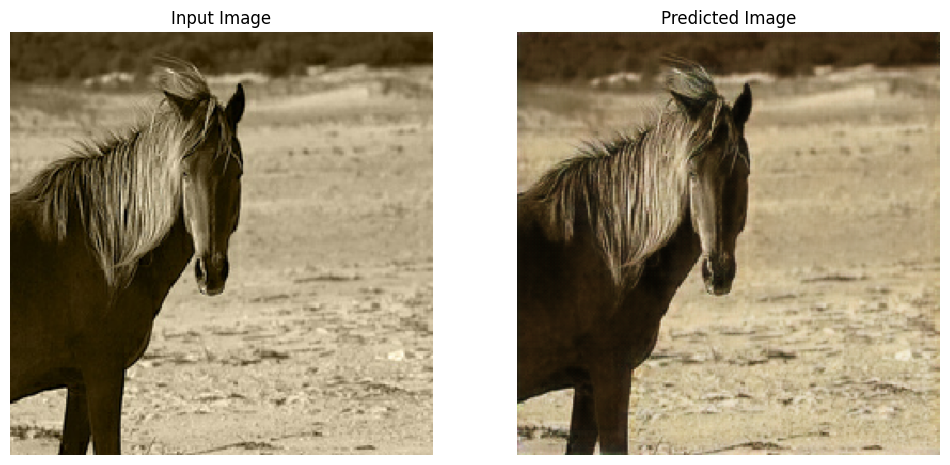

Time taken for epoch 33 is 183.3625521659851 sec

......................................................534
534
534


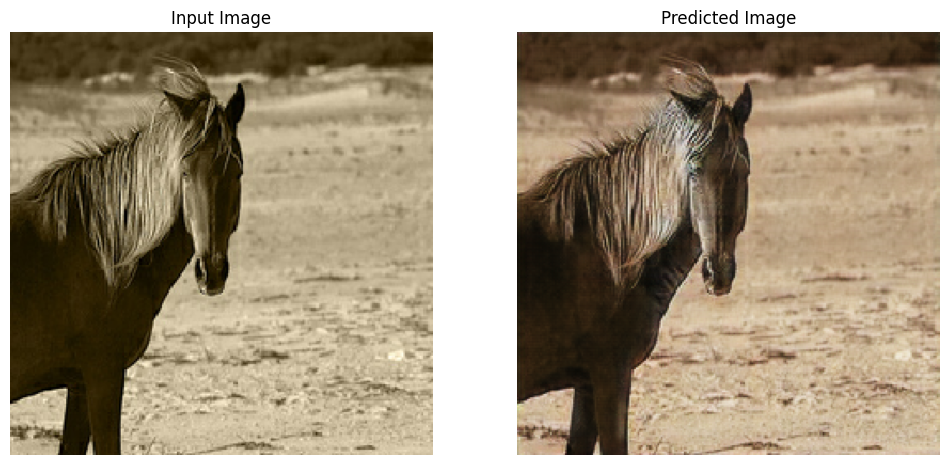

Time taken for epoch 34 is 185.38072991371155 sec

......................................................534
534
534


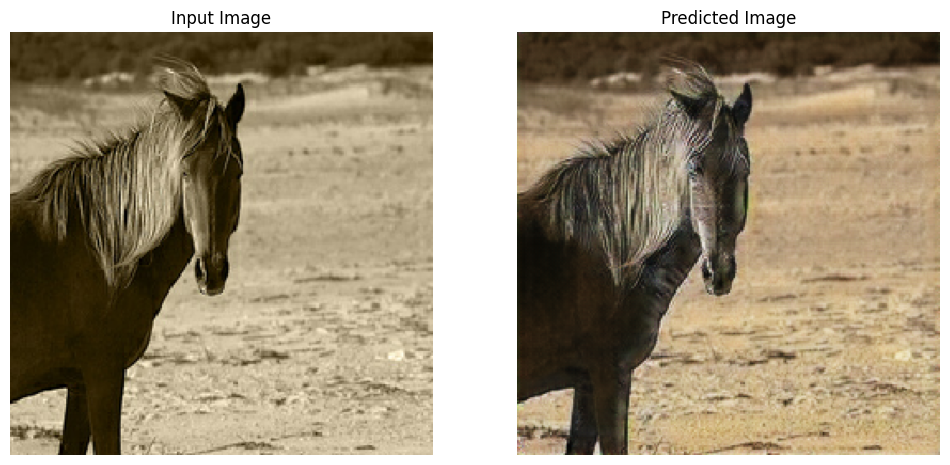

Saving checkpoint for epoch 35 at ./checkpoints/train\ckpt-20
Time taken for epoch 35 is 189.9493579864502 sec

......................................................534
534
534


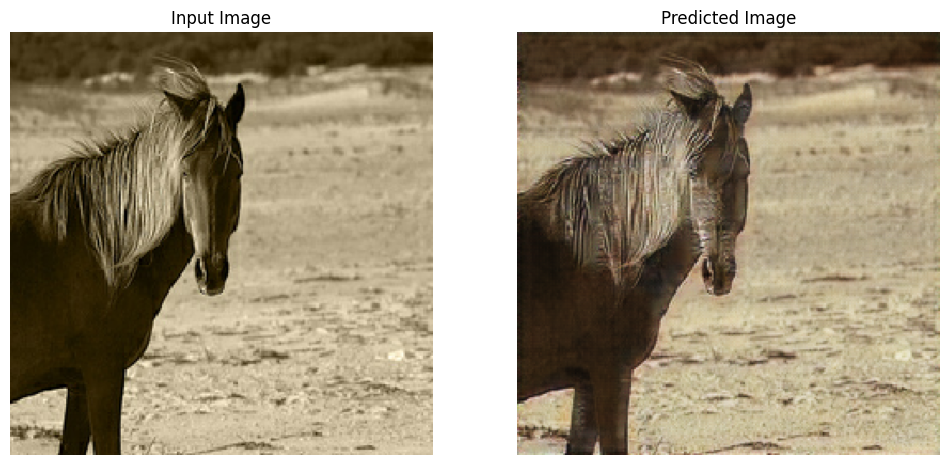

Time taken for epoch 36 is 184.25949120521545 sec

......................................................534
534
534


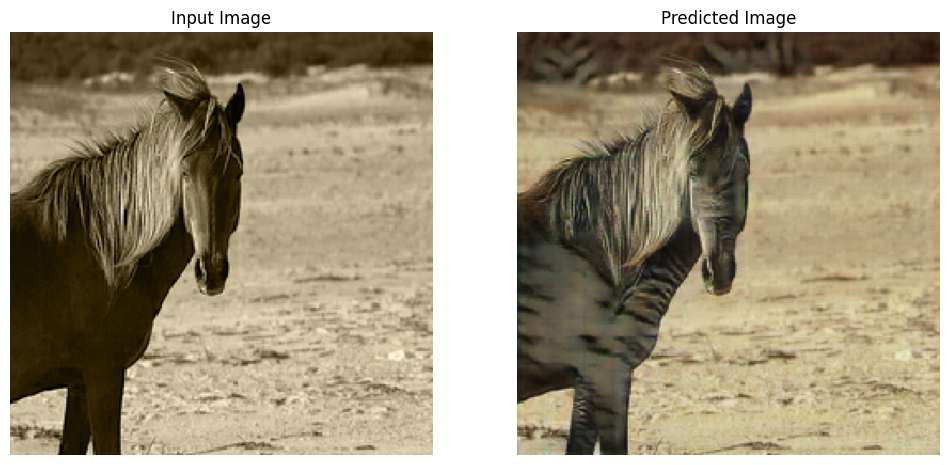

Time taken for epoch 37 is 184.70364141464233 sec

......................................................534
534
534


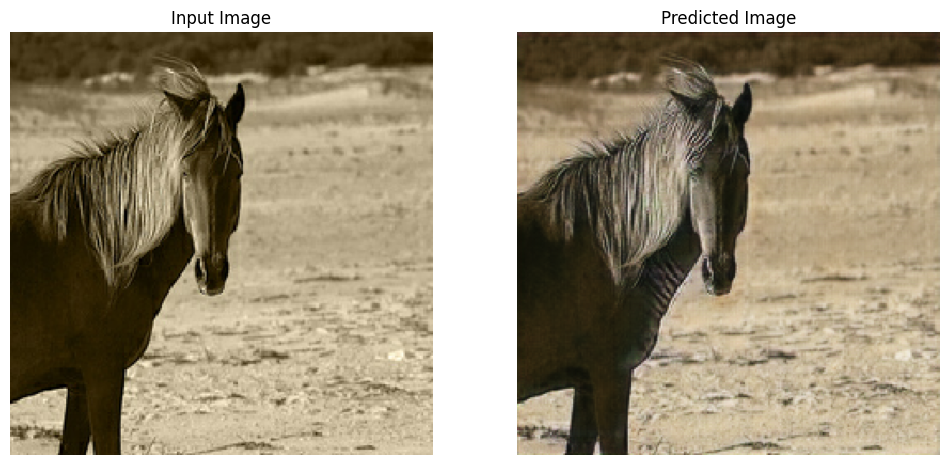

Time taken for epoch 38 is 183.6291925907135 sec

......................................................534
534
534


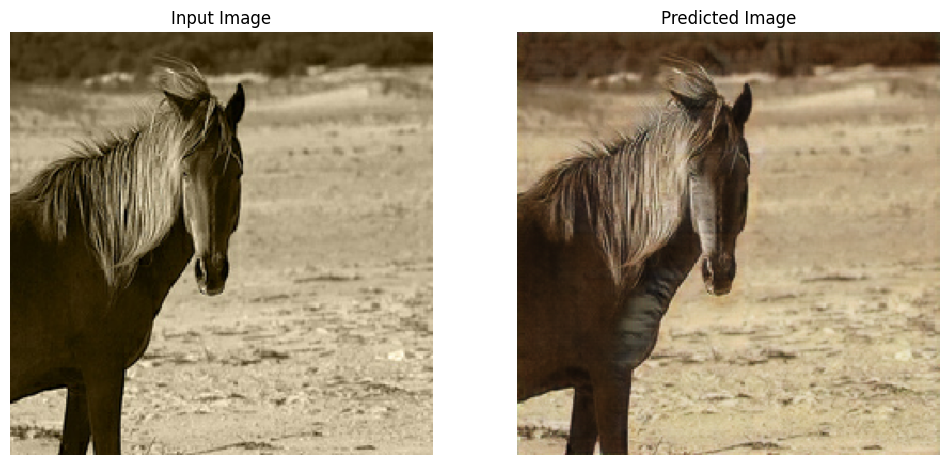

Time taken for epoch 39 is 184.30199337005615 sec

......................................................534
534
534


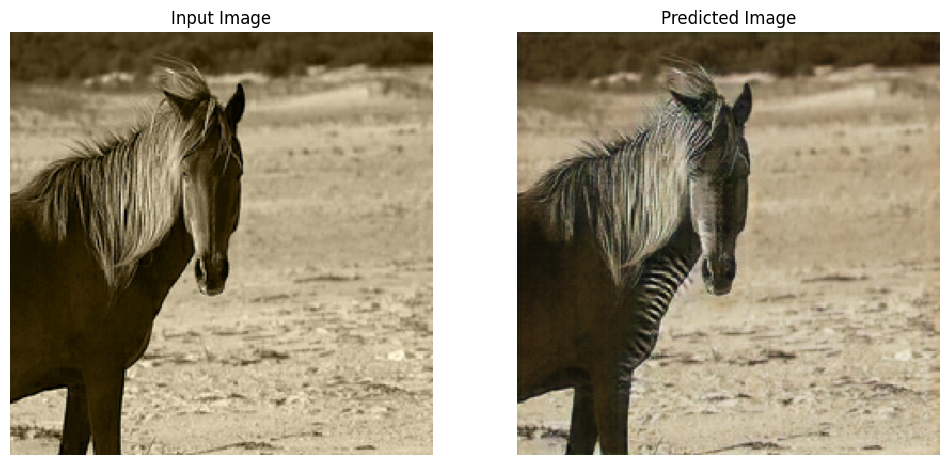

Saving checkpoint for epoch 40 at ./checkpoints/train\ckpt-21
Time taken for epoch 40 is 193.6808397769928 sec

......................................................534
534
534


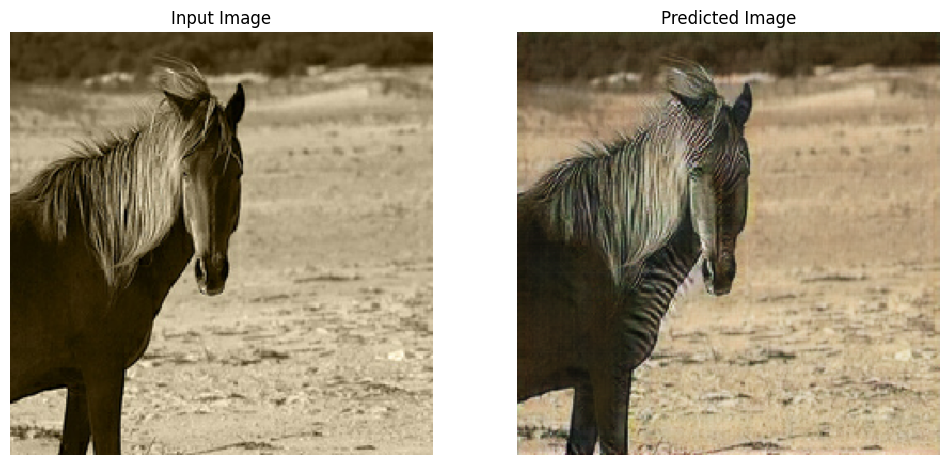

Time taken for epoch 41 is 184.6794707775116 sec

......................................................534
534
534


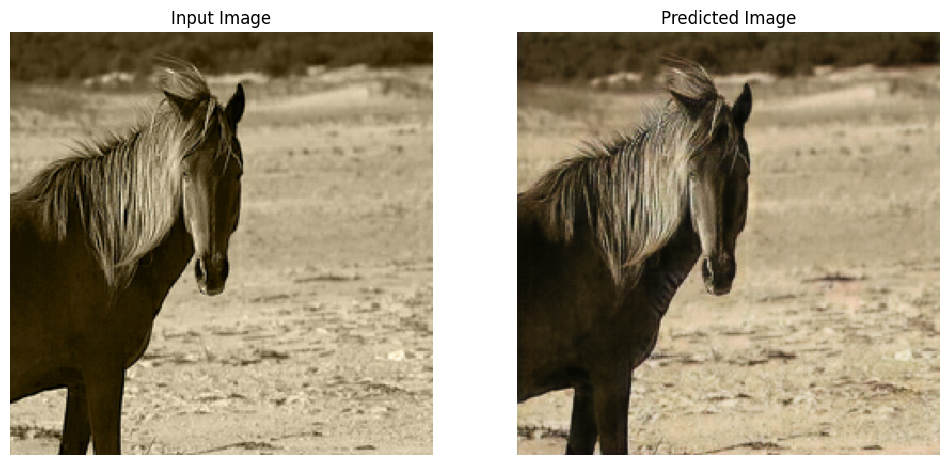

Time taken for epoch 42 is 185.2909872531891 sec

......................................................534
534
534


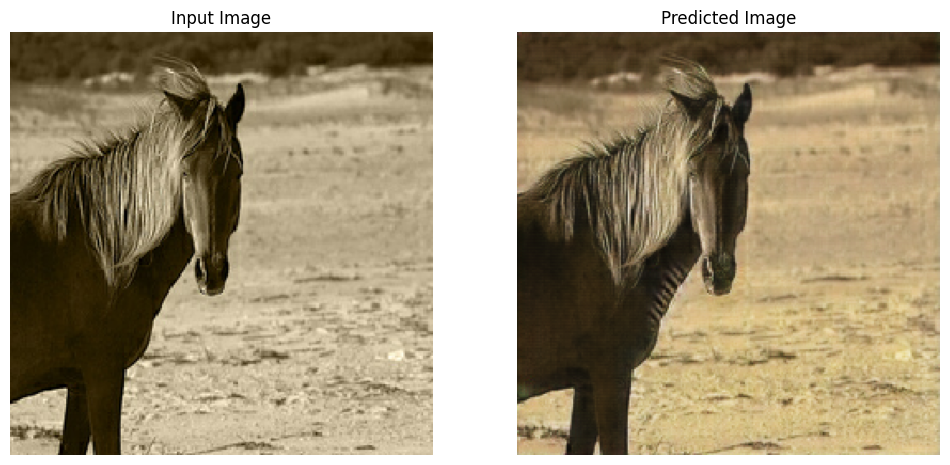

Time taken for epoch 43 is 184.97140169143677 sec

......................................................534
534
534


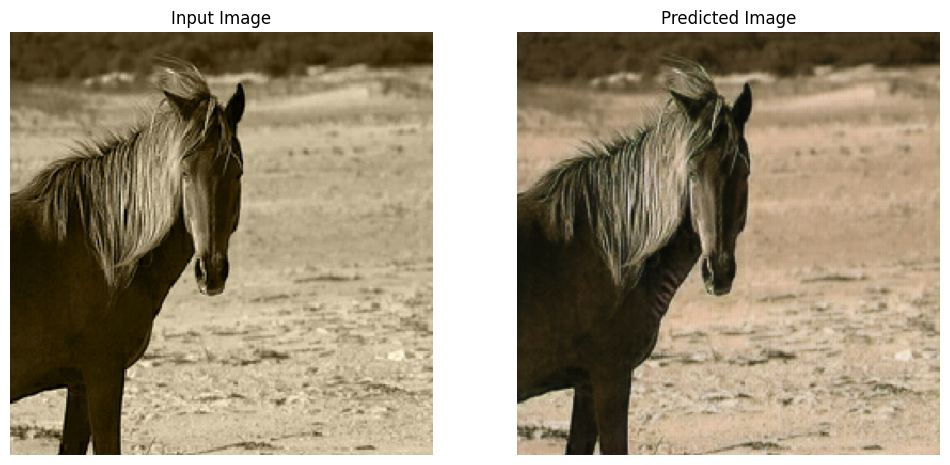

Time taken for epoch 44 is 185.89622616767883 sec

......................................................534
534
534


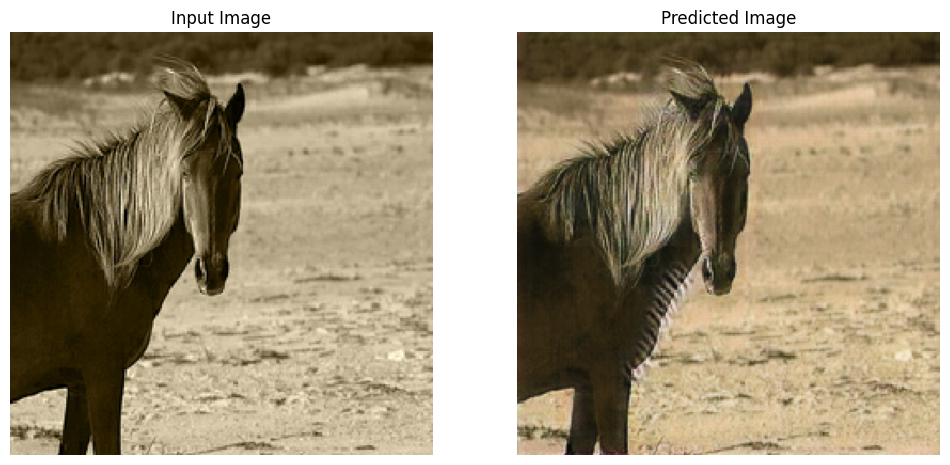

Saving checkpoint for epoch 45 at ./checkpoints/train\ckpt-22
Time taken for epoch 45 is 274.1362512111664 sec

......................................................534
534
534


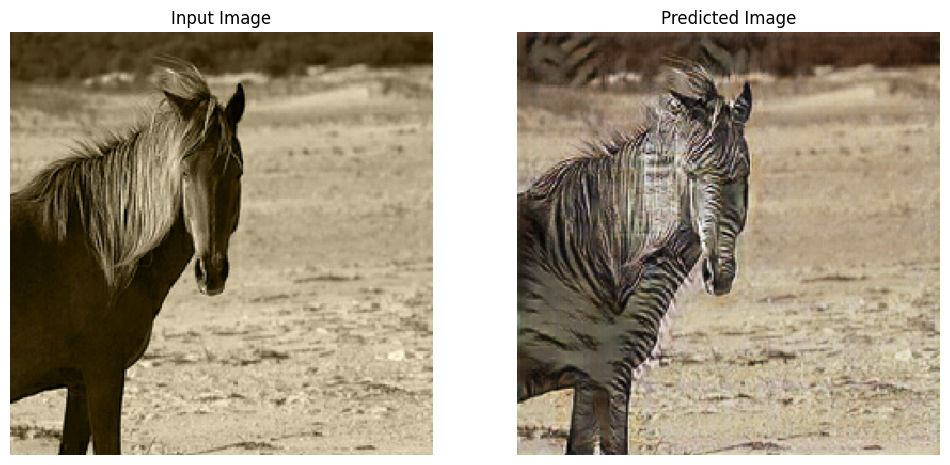

Time taken for epoch 46 is 269.9846863746643 sec

......................................................534
534
534


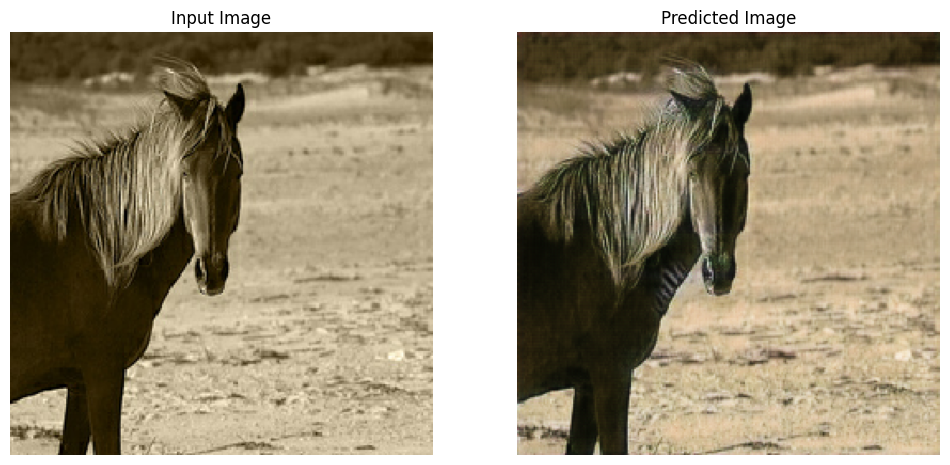

Time taken for epoch 47 is 265.51305079460144 sec

......................................................534
534
534


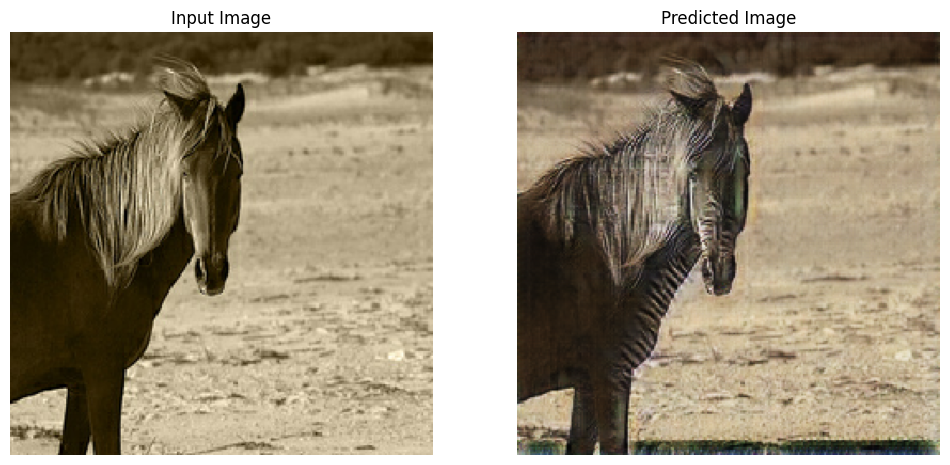

Time taken for epoch 48 is 264.23550033569336 sec

......................................................534
534
534


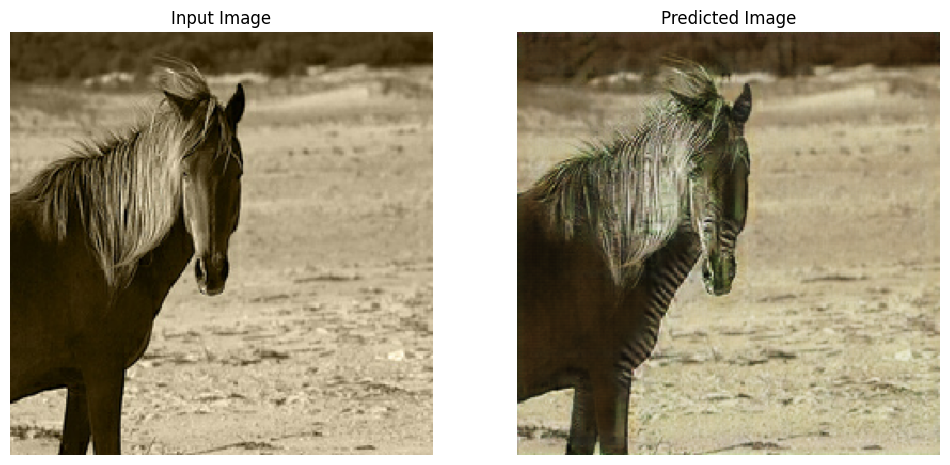

Time taken for epoch 49 is 255.52275466918945 sec

......................................................534
534
534


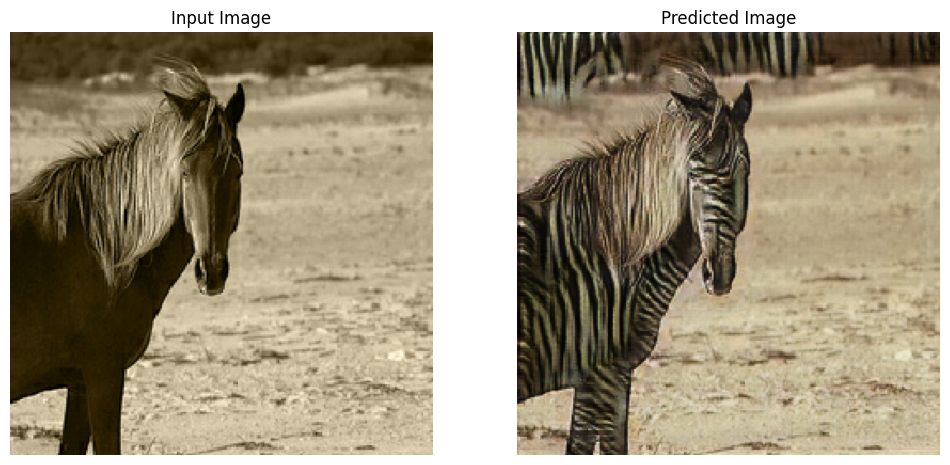

Saving checkpoint for epoch 50 at ./checkpoints/train\ckpt-23
Time taken for epoch 50 is 265.6818833351135 sec



In [29]:
l1_loss=[]
l2_loss=[]
total_cycle_loss_loss=[]
import numpy as np

for epoch in range(EPOCHS):
  start = time.time()
  aa=[]
  bb=[]
  cc=[]

  n = 0
  for image_x, image_y in tf.data.Dataset.zip((train_horses, train_zebras)):
    l1,l2,total_cycle_loss=train_step(image_x, image_y)
    
    aa.append(l1)
    bb.append(l2)
    cc.append(total_cycle_loss)
    
    if n % 10 == 0:
      print ('.', end='')
    n += 1
  aaa = [tensor.numpy() for tensor in aa]
  bbb = [tensor.numpy() for tensor in bb]
  ccc = [tensor.numpy() for tensor in cc]
  aaa = np.array(aaa)
  bbb = np.array(bbb)
  ccc = np.array(ccc)
  print(len(aaa))
  print(len(bbb))
  print(len(ccc))

  l1_loss.append(np.mean(aaa))
  l2_loss.append(np.mean(bbb))
  total_cycle_loss_loss.append(np.mean(ccc))
    

  generate_images(generator_g, sample_horse)

  if (epoch + 1) % 5 == 0:
    ckpt_save_path = ckpt_manager.save()
    print ('Saving checkpoint for epoch {} at {}'.format(epoch+1,
                                                         ckpt_save_path))

  print ('Time taken for epoch {} is {} sec\n'.format(epoch + 1,
                                                      time.time()-start))

In [30]:
# ckpt_save_path = ckpt_manager.save()

## Generate using test dataset

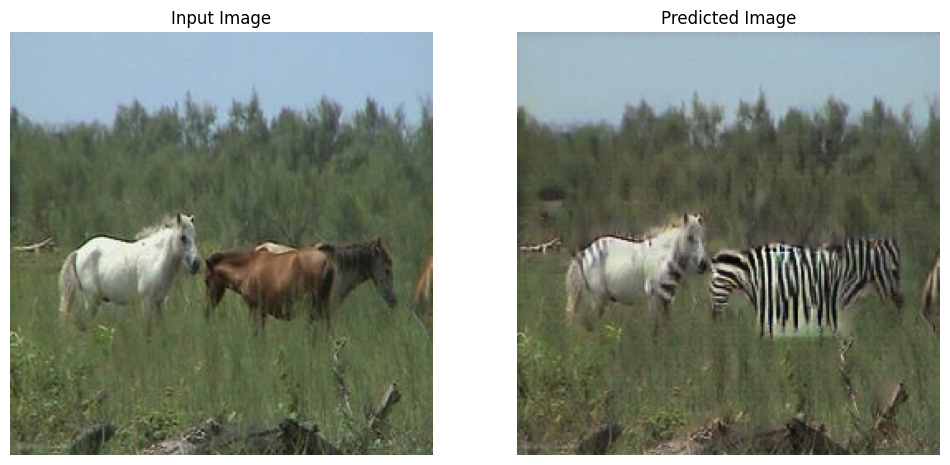

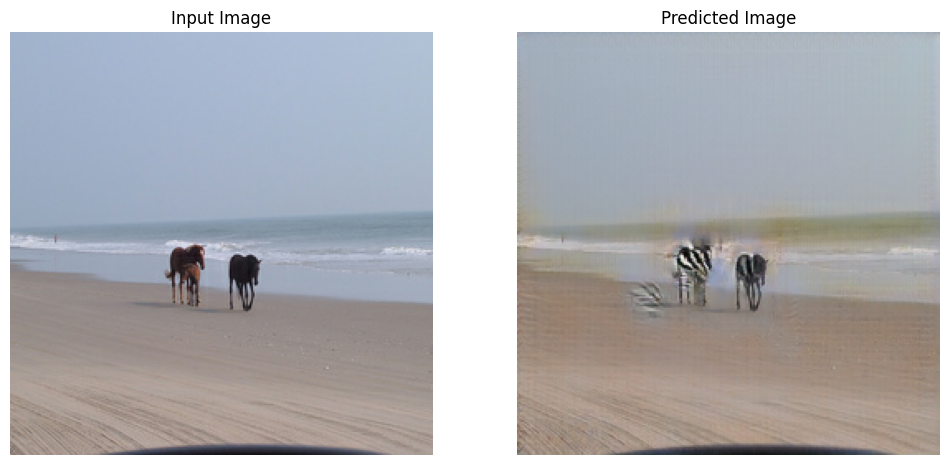

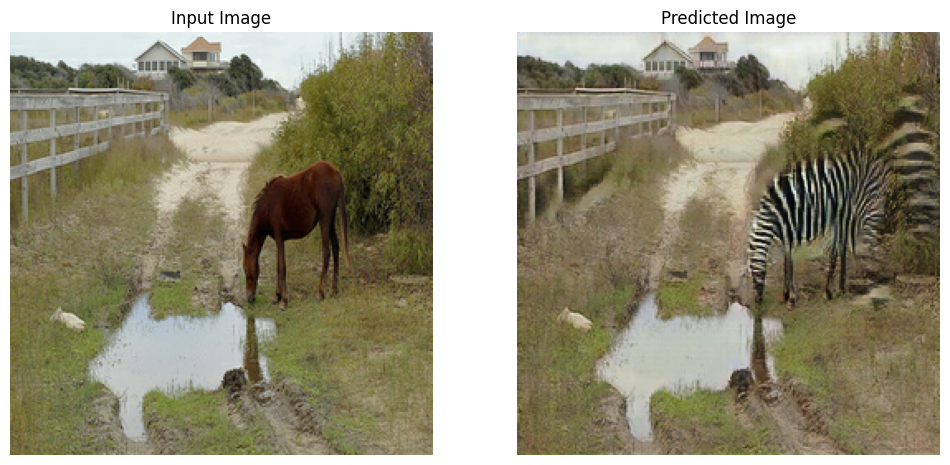

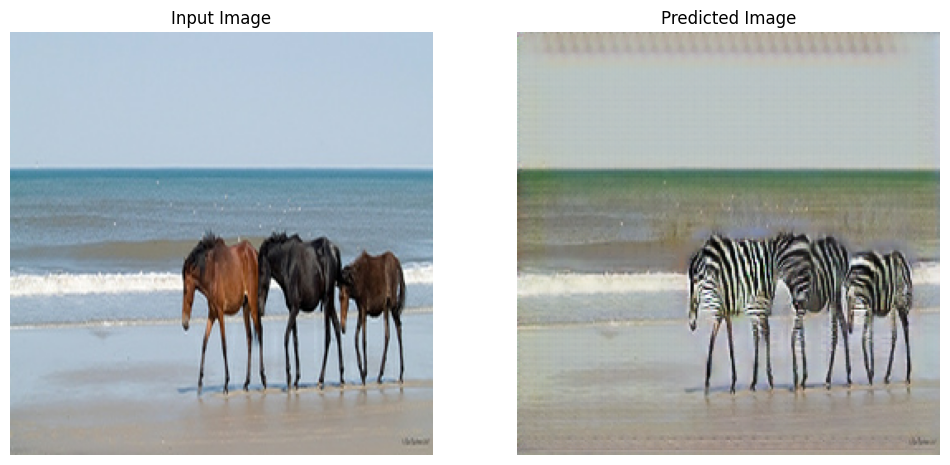

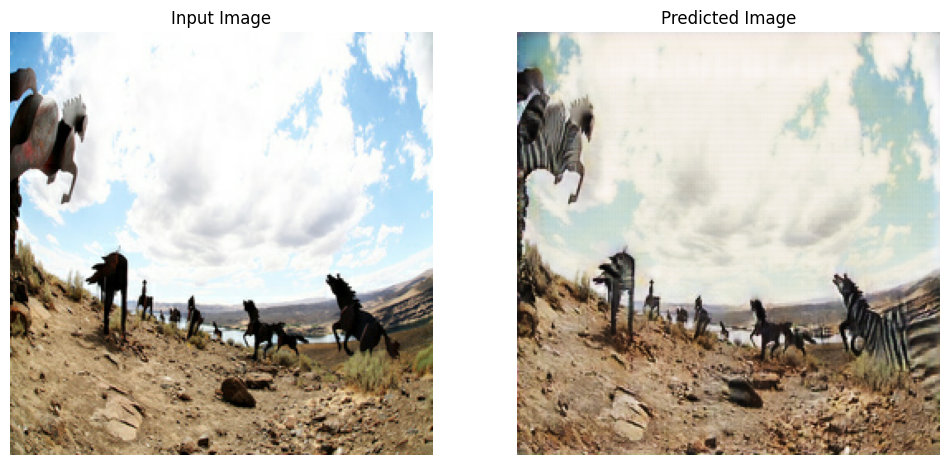

In [31]:

for inp in test_horses.take(5):
  generate_images(generator_g, inp)

In [32]:
print(len(l1_loss))

50


In [35]:
yy=np.arange(50)

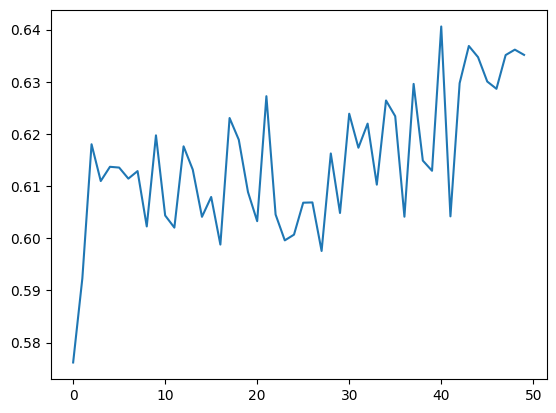

In [36]:
plt.plot(yy,l1_loss)
plt.show()

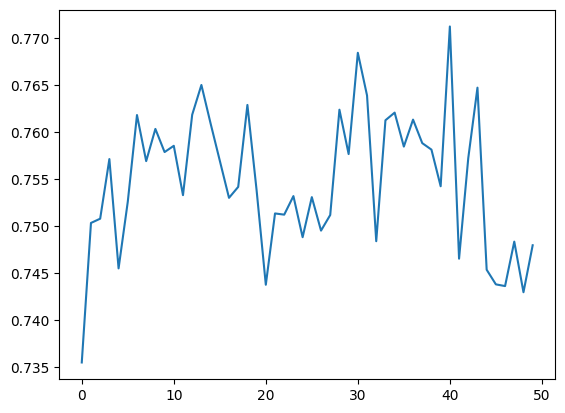

In [37]:
plt.plot(yy,l2_loss)
plt.show()

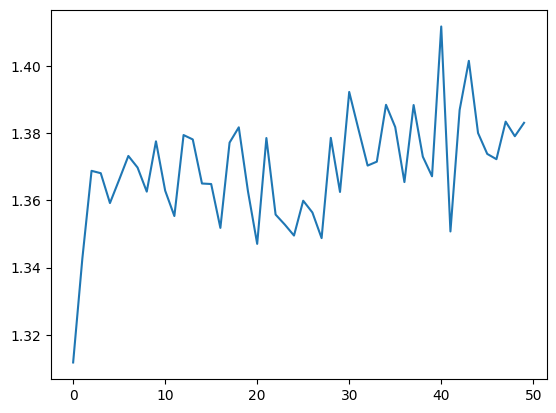

In [38]:
plt.plot(yy,total_cycle_loss_loss)
plt.show()